In [1]:
#필요한 라이브러리를 로드합니다. 
import os
import math
import numpy as np
import tensorflow as tf

import PIL
import skimage
import albumentations
from PIL import Image
import matplotlib.pyplot as plt
from skimage.io import imread
from skimage.transform import resize
from glob import glob
from tensorflow.keras import layers, models, backend as K
from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications import MobileNetV2
from functools import wraps
import numpy as np

In [2]:
from albumentations import  HorizontalFlip, RandomSizedCrop, Compose, OneOf, Resize

def build_augmentation(is_train=True):
    if is_train:    # 훈련용 데이터일 경우
        return Compose([
                        HorizontalFlip(p=0.5),    # 50%의 확률로 좌우대칭
                        RandomSizedCrop(         # 50%의 확률로 RandomSizedCrop
                            min_max_height=(300, 370),
                            w2h_ratio=370/1242,
                            height=224,
                            width=224,
                            p=0.5
                            ),
                        Resize(              # 입력이미지를 224X224로 resize
                            width=224,
                            height=224
                            )
                        ])
    
    return Compose([      # 테스트용 데이터일 경우에는 224X224로 resize만 수행합니다. 
                    Resize(
                        width=224,
                        height=224
                        )
                    ])

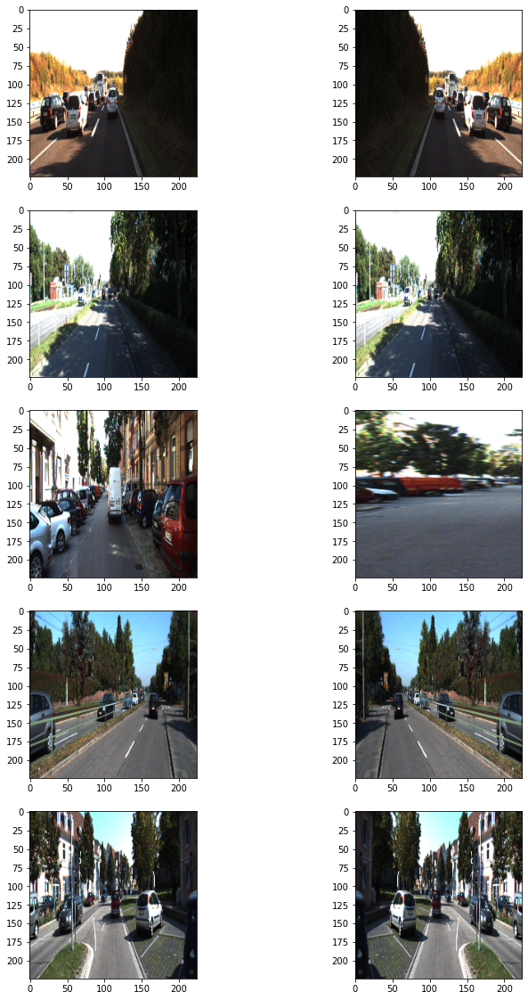

In [3]:
dir_path = os.getenv('HOME')+'/aiffel/semantic_segmentation/data/training'

augmentation_train = build_augmentation()
augmentation_test = build_augmentation(is_train=False)
input_images = glob(os.path.join(dir_path, "image_2", "*.png"))

# 훈련 데이터셋에서 5개만 가져와 augmentation을 적용해 봅시다.  
plt.figure(figsize=(12, 20))
for i in range(5):
    image = imread(input_images[i]) 
    image_data = {"image":image}
    resized = augmentation_test(**image_data)
    processed = augmentation_train(**image_data)
    plt.subplot(5, 2, 2*i+1)
    plt.imshow(resized["image"])  # 왼쪽이 원본이미지
    plt.subplot(5, 2, 2*i+2)
    plt.imshow(processed["image"])  # 오른쪽이 augment된 이미지

    
plt.show()

In [4]:
class KittiGenerator(tf.keras.utils.Sequence):
    """
    KittiGenerator는 tf.keras.utils.Sequence를 상속받습니다.
    우리가 KittiDataset을 원하는 방식으로 preprocess하기 위해서 Sequnce를 커스텀해 사용합니다.
    """
    def __init__(self, dir_path, batch_size=4, img_size=(224, 224, 3),
                 output_size=(224, 224), is_train=True, augmentation=None):
        """
        dir_path: dataset의 directory path입니다.
        batch_size: batch_size입니다.
        img_size: preprocess에 사용할 입력이미지의 크기입니다.
        output_size: ground_truth를 만들어주기 위한 크기입니다.
        is_train: 이 Generator가 학습용인지 테스트용인지 구분합니다.
        augmentation: 적용하길 원하는 augmentation 함수를 인자로 받습니다.
        """
        self.dir_path = dir_path
        self.batch_size = batch_size
        self.is_train = is_train
        self.augmentation = augmentation
        self.img_size = img_size
        self.output_size = output_size
        
        # load_dataset()을 통해서 kitti dataset의 directory path에서 라벨과 이미지를 확인합니다.
        self.data = self.load_dataset()

    def load_dataset(self):
        # kitti dataset에서 필요한 정보(이미지 경로 및 라벨)를 directory에서 확인하고 로드하는 함수입니다.
        # 이때 is_train에 따라 test set을 분리해서 load하도록 해야합니다.
        input_images = glob(os.path.join(self.dir_path, "image_2", "*.png"))
        label_images = glob(os.path.join(self.dir_path, "semantic", "*.png"))
        input_images.sort()
        label_images.sort()
        assert len(input_images) == len(label_images)
        data = [_ for _ in zip(input_images, label_images)]

        if self.is_train:
            return data[:-30]
        return data[-30:]

    def __len__(self):
        # Generator의 length로서 전체 dataset을 batch_size로 나누고 소숫점 첫째자리에서 올림한 값을 반환합니다.
        return math.ceil(len(self.data) / self.batch_size)

    def __getitem__(self, index):
        # 입력과 출력을 만듭니다.
        # 입력은 resize및 augmentation이 적용된 input image이고 
        # 출력은 semantic label입니다.
        batch_data = self.data[index*self.batch_size:(index + 1)*self.batch_size]
        inputs = np.zeros([self.batch_size, *self.img_size])
        outputs = np.zeros([self.batch_size, *self.output_size])

        for i, data in enumerate(batch_data):
            input_img_path, output_path = data
            _input = imread(input_img_path)
            _output = imread(output_path)
            _output = (_output == 7).astype(np.uint8) * 1
            data = {"image": _input, "mask": _output}
            augmented = self.augmentation(**data)
            inputs[i] = augmented["image"] / 255
            outputs[i] = augmented["mask"]
        return inputs, outputs

    def on_epoch_end(self):
        # 한 epoch가 끝나면 실행되는 함수입니다. 학습중인 경우에 순서를 random shuffle하도록 적용한 것을 볼 수 있습니다.
        self.indexes = np.arange(len(self.data))
        if self.is_train:
            np.random.shuffle(self.indexes)
        return self.indexes

In [5]:
augmentation = build_augmentation()
test_preproc = build_augmentation(is_train=False)
        
train_generator = KittiGenerator(
    dir_path, 
    augmentation=augmentation,
)

test_generator = KittiGenerator(
    dir_path, 
    augmentation=test_preproc,
    is_train=False
)

In [6]:
# Define the convolutional block
def conv_block(input_tensor, num_filters, dropout_rate=0.0):
    """입력 텐서에 2개의 컨볼루션 레이어를 추가하는 함수"""
    # 첫 번째 레이어
    x = layers.Conv2D(num_filters, (3, 3), padding="same")(input_tensor)  # 입력 텐서에 3x3 크기의 컨볼루션 레이어를 적용합니다.
    x = layers.Activation("relu")(x)  # ReLU 활성화 함수를 적용합니다.

    # 드롭아웃 적용 (선택적)
    if dropout_rate > 0:  # 드롭아웃 비율이 0보다 크면 드롭아웃 레이어를 추가합니다.
        x = layers.Dropout(dropout_rate)(x)

    # 두 번째 레이어
    x = layers.Conv2D(num_filters, (3, 3), padding="same")(x)  # 두 번째 3x3 크기의 컨볼루션 레이어를 적용합니다.
    x = layers.Activation("relu")(x)  # ReLU 활성화 함수를 적용합니다.
    return x  # 결과 텐서를 반환합니다.

# Define the encoder block
def encoder_block(input_tensor, num_filters):
    x = conv_block(input_tensor, num_filters)  # 컨볼루션 블록을 적용합니다.
    p = layers.MaxPooling2D((2, 2))(x)  # 2x2 맥스 풀링을 적용하여 특징 맵의 크기를 줄입니다.
    return x, p  # 컨볼루션 블록의 출력과 풀링 레이어의 출력을 반환합니다.

# Define the decoder block
def decoder_block(input_tensor, concat_tensor, num_filters):
    x = layers.Conv2DTranspose(num_filters, (2, 2), strides=(2, 2), padding="same")(input_tensor)  # 업샘플링을 위해 전치 컨볼루션을 적용합니다.
    x = layers.concatenate([x, concat_tensor], axis=-1)  # 업샘플링된 특징 맵과 인코더의 해당 특징 맵을 연결합니다.
    x = conv_block(x, num_filters)  # 연결된 특징 맵에 컨볼루션 블록을 적용합니다.
    return x  # 결과 텐서를 반환합니다.

# Define the U-Net model
def build_model(input_shape=(224, 224, 3), num_classes=1):
    inputs = tf.keras.Input(shape=input_shape)  # 입력 텐서를 정의합니다.

    # Encoder
    x1, p1 = encoder_block(inputs, 64)  # 첫 번째 인코더 블록을 적용합니다.
    x2, p2 = encoder_block(p1, 128)  # 두 번째 인코더 블록을 적용합니다.
    x3, p3 = encoder_block(p2, 256)  # 세 번째 인코더 블록을 적용합니다.
    x4, p4 = encoder_block(p3, 512)  # 네 번째 인코더 블록을 적용합니다.

    # Bridge
    b = conv_block(p4, 1024, dropout_rate=0.5)  # 가장 깊은 부분에서 컨볼루션 블록을 적용합니다. 여기에는 드롭아웃도 포함됩니다.

    # Decoder
    d1 = decoder_block(b, x4, 512)  # 첫 번째 디코더 블록을 적용합니다.
    d2 = decoder_block(d1, x3, 256)  # 두 번째 디코더 블록을 적용합니다.
    d3 = decoder_block(d2, x2, 128)  # 세 번째 디코더 블록을 적용합니다.
    d4 = decoder_block(d3, x1, 64)  # 네 번째 디코더 블록을 적용합니다.

    # Output
    outputs = layers.Conv2D(num_classes, (1, 1), activation="sigmoid")(d4)  # 최종 출력 레이어를 정의합니다. 여기서는 1x1 컨볼루션을 사용하여 원하는 클래스 수에 맞는 출력을 생성합니다. 이진 분류를 위해 sigmoid 활성화 함수를 사용합니다.

    model = models.Model(inputs, outputs, name="U-Net")  # 입력과 출력을 사용하여 U-Net 모델을 정의합니다.
    return model  # 모델을 반환합니다.



In [7]:
build_unet = build_model()

# 모델 요약을 출력합니다.
build_unet.summary()

Model: "U-Net"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 224, 224, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
activation (Activation)         (None, 224, 224, 64) 0           conv2d[0][0]                     
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 224, 224, 64) 36928       activation[0][0]                 
______________________________________________________________________________________________

In [8]:
def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred = K.cast(y_pred, 'float32')
    y_pred_f = K.cast(K.greater(K.flatten(y_pred), 0.5), 'float32')
    intersection = y_true_f * y_pred_f
    score = 2. * K.sum(intersection) / (K.sum(y_true_f) + K.sum(y_pred_f))
    return score

def dice_loss(y_true, y_pred):
    smooth = 1.
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = y_true_f * y_pred_f
    score = (2. * K.sum(intersection) + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)
    return 1. - score

def bce_dice_loss(y_true, y_pred):
    return tf.keras.losses.binary_crossentropy(y_true, y_pred) + dice_loss(y_true, y_pred)

def bce_logdice_loss(y_true, y_pred):
    return tf.keras.losses.binary_crossentropy(y_true, y_pred) - K.log(1. - dice_loss(y_true, y_pred))

In [9]:
def Transpose2D_block(filters, stage, cols, kernel_size=(3,3), upsample_rate=(2,2),
                      transpose_kernel_size=(4,4), use_batchnorm=False, skip=None):

    def layer(input_tensor):

        conv_name, bn_name, relu_name, up_name, merge_name = handle_block_names(stage, cols)

        x = Conv2DTranspose(filters, transpose_kernel_size, strides=upsample_rate,
                            padding='same', name=up_name, use_bias=not(use_batchnorm))(input_tensor)
        if use_batchnorm:
            x = BatchNormalization(name=bn_name+'1')(x)
        x = Activation('relu', name=relu_name+'1')(x)

        if (type(skip) != list and skip is not None) or (type(skip) == list and None not in skip):
            # print("\nskip = {}".format(skip))
            if type(skip) is list:
                merge_list = []
                merge_list.append(x)
                for l in skip:
                    merge_list.append(l)
                x = Concatenate(name=merge_name)(merge_list)
            else:
                x = Concatenate(name=merge_name)([x, skip])

        x = ConvRelu(filters, kernel_size, use_batchnorm=use_batchnorm,
                     conv_name=conv_name + '2', bn_name=bn_name + '2', relu_name=relu_name + '2')(x)

        return x
    return layer

In [10]:
import tensorflow as tf
from tensorflow.keras import layers, models, backend as K

# Custom loss functions
def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred = K.cast(y_pred, 'float32')
    y_pred_f = K.cast(K.greater(K.flatten(y_pred), 0.5), 'float32')
    intersection = y_true_f * y_pred_f
    score = 2. * K.sum(intersection) / (K.sum(y_true_f) + K.sum(y_pred_f))
    return score

def dice_loss(y_true, y_pred):
    smooth = 1.
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = y_true_f * y_pred_f
    score = (2. * K.sum(intersection) + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)
    return 1. - score

def bce_dice_loss(y_true, y_pred):
    return tf.keras.losses.binary_crossentropy(y_true, y_pred) + dice_loss(y_true, y_pred)

def bce_logdice_loss(y_true, y_pred):
    return tf.keras.losses.binary_crossentropy(y_true, y_pred) - K.log(1. - dice_loss(y_true, y_pred))

# Convolutional block
def conv_block_plus(input_tensor, num_filters, dropout_rate=0.0):
    x = layers.Conv2D(num_filters, (3, 3), padding="same")(input_tensor)
    x = layers.Activation("relu")(x)

    if dropout_rate > 0:
        x = layers.Dropout(dropout_rate)(x)

    x = layers.Conv2D(num_filters, (3, 3), padding="same")(x)
    x = layers.Activation("relu")(x)
    return x

# Encoder block
def encoder_block_plus(input_tensor, num_filters):
    x = conv_block_plus(input_tensor, num_filters)
    p = layers.MaxPooling2D((2, 2))(x)
    return x, p

# Decoder block using Transpose2D
def decoder_block_plus(input_tensor, concat_tensor, num_filters):
    x = layers.Conv2DTranspose(num_filters, (2, 2), strides=(2, 2), padding="same")(input_tensor)
    x = layers.concatenate([x, concat_tensor], axis=-1)
    x = conv_block_plus(x, num_filters)
    return x

# Build U-Net++ model
def build_unetplusplus(input_shape=(224, 224, 3), num_classes=1):
    inputs = tf.keras.Input(shape=input_shape)

    # Encoder
    x1, p1 = encoder_block_plus(inputs, 64)
    x2, p2 = encoder_block_plus(p1, 128)
    x3, p3 = encoder_block_plus(p2, 256)
    x4, p4 = encoder_block_plus(p3, 512)

    # Bridge
    b = conv_block_plus(p4, 1024, dropout_rate=0.5)

    # Decoder
    d1 = decoder_block_plus(b, x4, 512)
    d2 = decoder_block_plus(d1, x3, 256)
    d3 = decoder_block_plus(d2, x2, 128)
    d4 = decoder_block_plus(d3, x1, 64)

    # Nested connections
    d1_nest = decoder_block_plus(x4, x3, 256)
    d2_nest = decoder_block_plus(d1_nest, x2, 128)
    d3_nest = decoder_block_plus(d2_nest, x1, 64)

    d2_nest2 = decoder_block_plus(x3, x2, 128)
    d3_nest2 = decoder_block_plus(d2_nest2, x1, 64)

    d3_nest3 = decoder_block_plus(x2, x1, 64)

    # Final layer
    final_concat = layers.concatenate([d4, d3_nest, d3_nest2, d3_nest3], axis=-1)
    outputs = layers.Conv2D(num_classes, (1, 1), activation="sigmoid")(final_concat)

    model = models.Model(inputs, outputs, name="U-NetPlusPlus")
    return model

# Example of building the model
model_unet_plus_plus = build_unetplusplus()
model_unet_plus_plus.compile(optimizer='adam', loss=bce_dice_loss)


In [11]:
# 모델 요약을 출력합니다.
model_unet_plus_plus.summary()

Model: "U-NetPlusPlus"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d_19 (Conv2D)              (None, 224, 224, 64) 1792        input_2[0][0]                    
__________________________________________________________________________________________________
activation_18 (Activation)      (None, 224, 224, 64) 0           conv2d_19[0][0]                  
__________________________________________________________________________________________________
conv2d_20 (Conv2D)              (None, 224, 224, 64) 36928       activation_18[0][0]              
______________________________________________________________________________________

In [12]:
model_plus_plus_path = os.getenv('HOME')+'/aiffel/semantic_segmentation/seg_model_unet_plus_plus.h5'


# EarlyStopping 콜백을 설정합니다.
earlystopper = EarlyStopping(
    monitor='val_loss',  # 검증 손실을 기준으로 합니다.
    patience=30,  # 성능 향상이 10 에포크 동안 없으면 학습을 멈춥니다.
    verbose=1,
    mode='min',  # 'min'은 val_loss가 감소하는 것을 기대합니다.
    restore_best_weights=True  # 가장 좋은 모델의 가중치를 복원합니다.
)

# 모델을 학습시킵니다.
model_unet_plus_plus.fit(
    train_generator,
    validation_data=test_generator,
    steps_per_epoch=len(train_generator),
    epochs=100,
#     callbacks=[earlystopper]  # 콜백을 추가합니다.
)



Epoch 1/100
43/43 [==============================] - 29s 425ms/step - loss: 1.2204 - val_loss: 1.0556
Epoch 2/100
43/43 [==============================] - 18s 403ms/step - loss: 0.8131 - val_loss: 0.4949
Epoch 3/100
43/43 [==============================] - 18s 407ms/step - loss: 0.7685 - val_loss: 0.6658
Epoch 4/100
43/43 [==============================] - 17s 402ms/step - loss: 0.6562 - val_loss: 0.5115
Epoch 5/100
43/43 [==============================] - 17s 399ms/step - loss: 0.5101 - val_loss: 0.9490
Epoch 6/100
43/43 [==============================] - 17s 402ms/step - loss: 0.5438 - val_loss: 0.8057
Epoch 7/100
43/43 [==============================] - 17s 401ms/step - loss: 0.5142 - val_loss: 0.7036
Epoch 8/100
43/43 [==============================] - 17s 397ms/step - loss: 0.4389 - val_loss: 0.6971
Epoch 9/100
43/43 [==============================] - 17s 397ms/step - loss: 0.4767 - val_loss: 0.5516
Epoch 10/100
43/43 [==============================] - 17s 400ms/step - loss: 0.366

NameError: name 'model_unet_plus_plus_' is not defined

In [13]:
model_unet_plus_plus.save(model_plus_plus_path)

In [14]:
# 모델 저장 경로 설정
model_path = os.getenv('HOME')+'/aiffel/semantic_segmentation/seg_model_unet_custom.h5'

# 모델 구축 및 컴파일
model = build_model()
model.compile(optimizer=Adam(1e-4), loss='binary_crossentropy')

# EarlyStopping 콜백 설정
earlystopper = EarlyStopping(
    monitor='val_loss',
    patience=30,
    verbose=1,
    mode='min',
    restore_best_weights=True
)

# 모델 학습
model.fit(
    train_generator,
    validation_data=test_generator,
    steps_per_epoch=len(train_generator),
    epochs=200,
#     callbacks=[earlystopper]  # 콜백 추가
)

# 학습한 모델 저장
model.save(model_path)

Epoch 1/200
43/43 [==============================] - 11s 232ms/step - loss: 0.6207 - val_loss: 0.5732
Epoch 2/200
43/43 [==============================] - 10s 227ms/step - loss: 0.4419 - val_loss: 0.3718
Epoch 3/200
43/43 [==============================] - 10s 225ms/step - loss: 0.2727 - val_loss: 0.2690
Epoch 4/200
43/43 [==============================] - 10s 223ms/step - loss: 0.2590 - val_loss: 0.2543
Epoch 5/200
43/43 [==============================] - 10s 221ms/step - loss: 0.2477 - val_loss: 0.2228
Epoch 6/200
43/43 [==============================] - 10s 221ms/step - loss: 0.2298 - val_loss: 0.3173
Epoch 7/200
43/43 [==============================] - 10s 220ms/step - loss: 0.2280 - val_loss: 0.2740
Epoch 8/200
43/43 [==============================] - 10s 221ms/step - loss: 0.2222 - val_loss: 0.2897
Epoch 9/200
43/43 [==============================] - 10s 221ms/step - loss: 0.2256 - val_loss: 0.2423
Epoch 10/200
43/43 [==============================] - 10s 222ms/step - loss: 0.192

In [24]:
model_unet_plus_plus

In [25]:
model = tf.keras.models.load_model(model_path)

In [40]:
def get_output(model, preproc, image_path, output_path):
    # 이미지 읽기
    origin_img = imread(image_path)
    data = {"image": origin_img}

    # 이미지 전처리
    processed = preproc(**data)

    # 모델을 통한 예측
    output = model(np.expand_dims(processed["image"] / 255, axis=0))
    output = (output[0].numpy() > 0.5).astype(np.uint8).squeeze(-1) * 255

    # 출력 이미지 생성
    output = Image.fromarray(output)
    background = Image.fromarray(origin_img).convert('RGBA')
    output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
    output = Image.blend(background, output, alpha=0.5)

    # 결과 출력
    output.show()
    return output


In [44]:
def get_output(model, preproc, image_path, output_path, label_path):
    origin_img = imread(image_path)
    data = {"image":origin_img}
    processed = preproc(**data)
    output = model(np.expand_dims(processed["image"]/255,axis=0))
    output = (output[0].numpy()>=0.5).astype(np.uint8).squeeze(-1)*255  #0.5라는 threshold를 변경하면 도로인식 결과범위가 달라집니다.
    prediction = output/255   # 도로로 판단한 영역
    
    output = Image.fromarray(output)
    background = Image.fromarray(origin_img).convert('RGBA')
    output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
    output = Image.blend(background, output, alpha=0.5)
    output.show()   # 도로로 판단한 영역을 시각화!
     
    if label_path:   
        label_img = imread(label_path)
        label_data = {"image":label_img}
        label_processed = preproc(**label_data)
        label_processed = label_processed["image"]
        target = (label_processed == 7).astype(np.uint8)*1   # 라벨에서 도로로 기재된 영역

        return output, prediction, target
    else:
        return output, prediction, _

In [45]:
def calculate_iou_score(target, prediction):
    # Ensure the arrays are boolean
    target = np.asarray(target).astype(bool)  # Updated to use bool
    prediction = np.asarray(prediction).astype(bool)  # Updated to use bool

    # Calculate the intersection of the two arrays
    intersection = np.logical_and(target, prediction).sum()

    # Calculate the union of the two arrays
    union = np.logical_or(target, prediction).sum()

    # Calculate the IoU score
    iou_score = float(intersection) / (union + 1e-6)
    
    print('IoU : %f' % iou_score)
    return iou_score


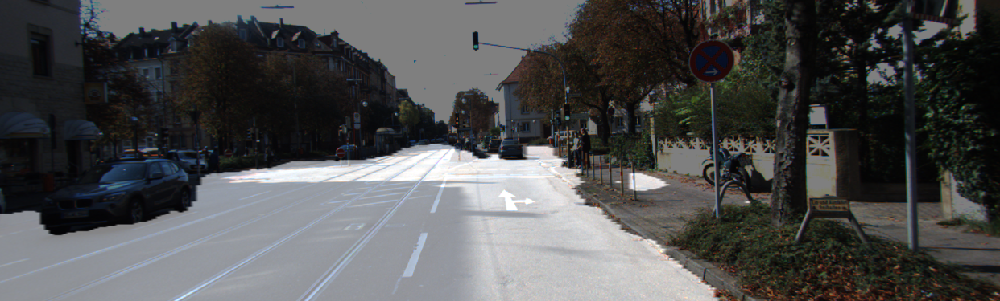

In [32]:
output, prediction, target = get_output(
     model, 
     test_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )


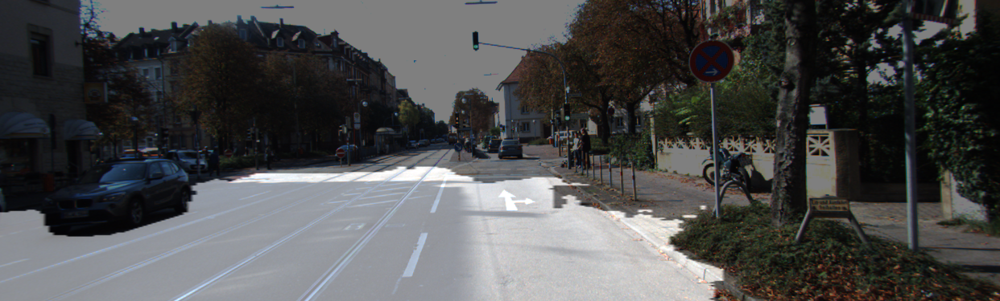

In [33]:
output_plus, prediction_plus, target_plus = get_output(
     model_unet_plus_plus, 
     test_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )


In [34]:
calculate_iou_score(target, prediction)

IoU : 0.944683


0.9446830958667056

In [35]:
calculate_iou_score(target_plus, prediction_plus)

IoU : 0.894593


0.894592744627379

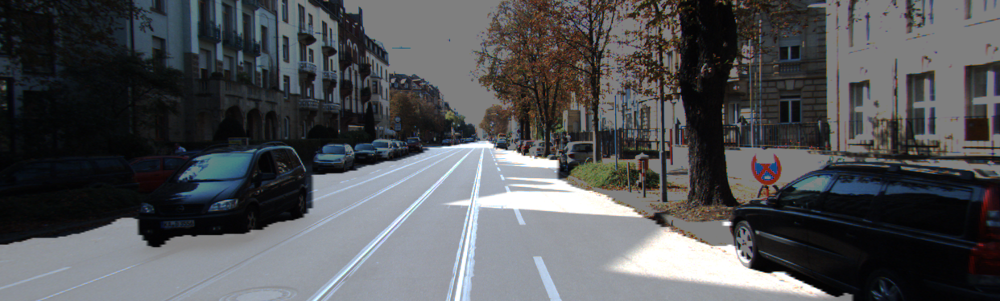

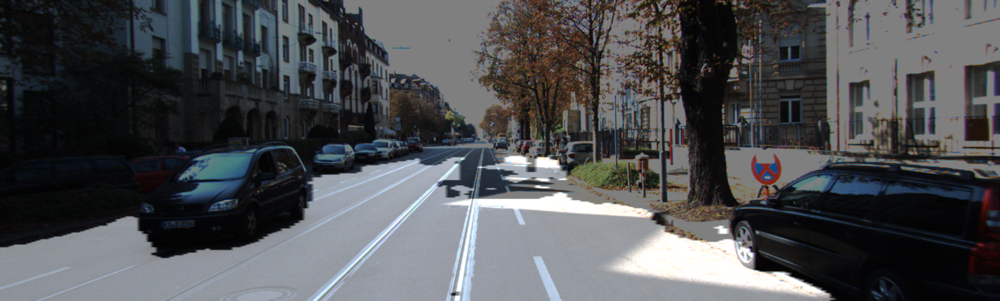

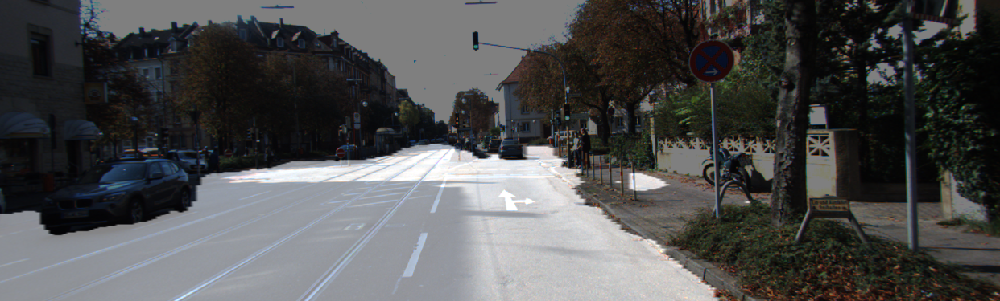

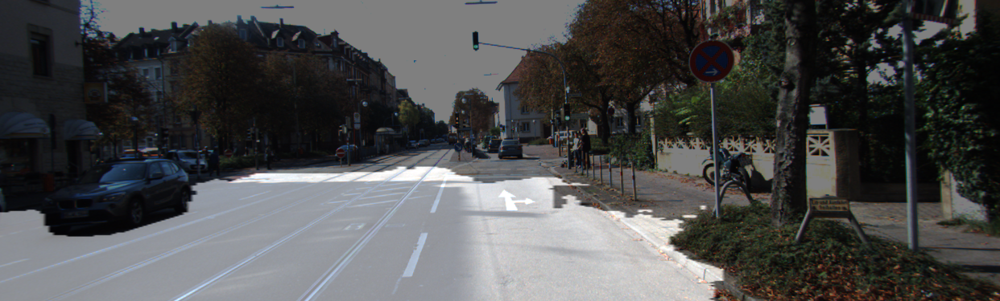

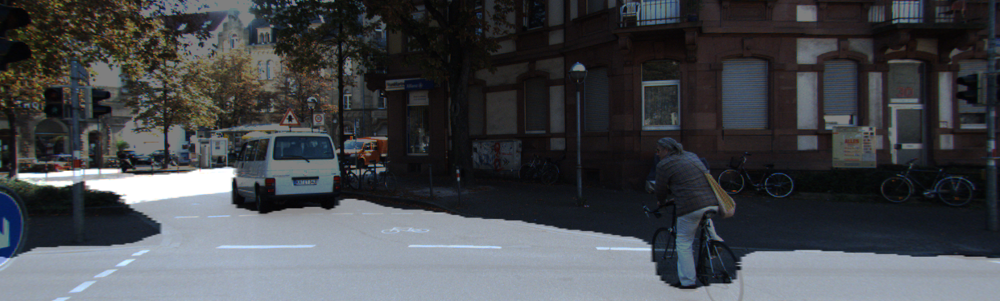

...

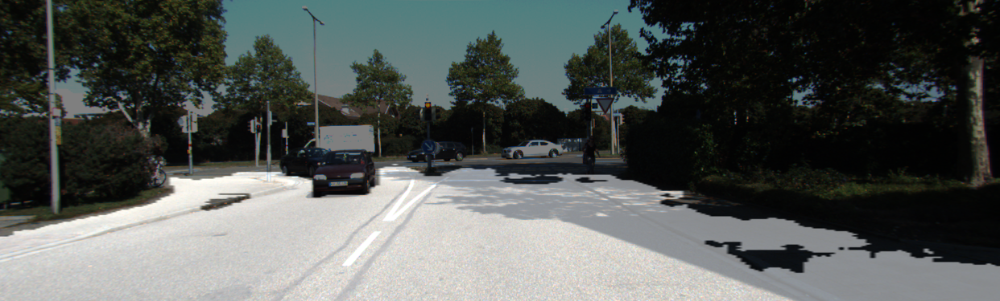

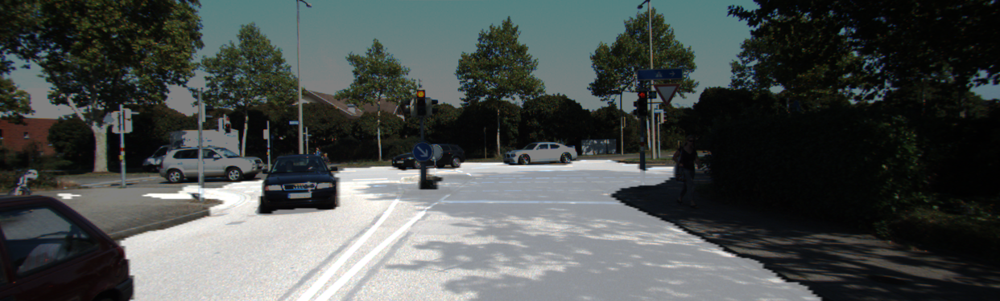

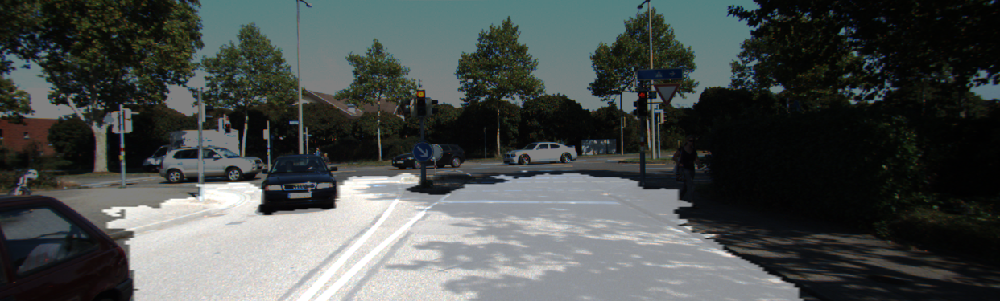

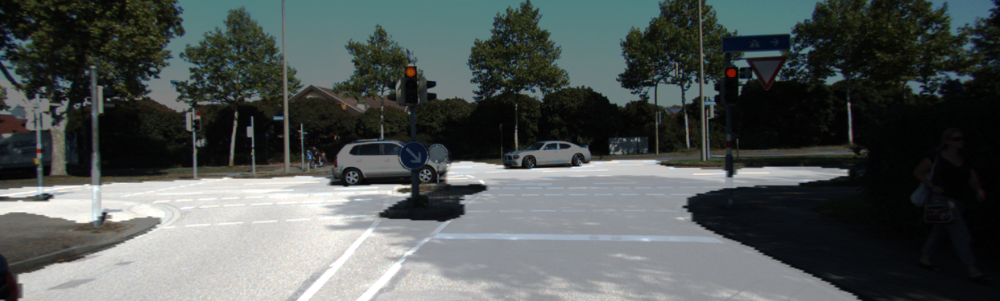

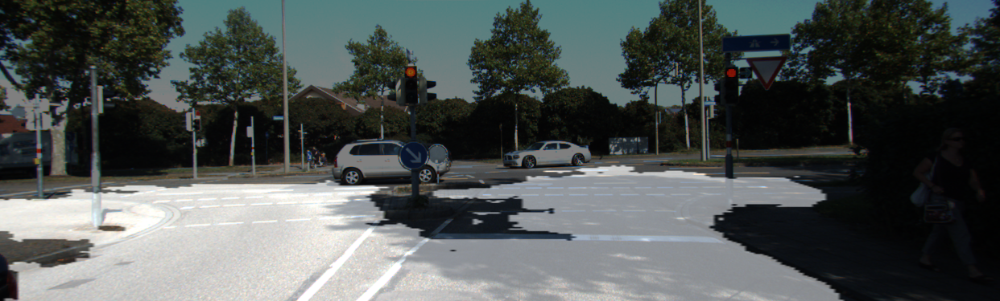

In [50]:
for i in range(10):
     output, prediction, target = get_output(
     model, 
     test_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
     )
     output_plus, prediction_plus, target_plus = get_output(
     model_unet_plus_plus, 
     test_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
     )

### 회고록
U-Net은 에폭은 200을 주고 U-Net++는 에폭을 100을 주니 기존 UNet이 훨씬 정확하게 도로를 짚었다.   
하지만 자동차 바퀴밑과 같은 디테일한 부분은 UNet++가 상대적으로 조금 잘 잡아냈는데   
이러한 디테일로 인해서 IOU가 상대적으로 적게 나온게 아닌가 싶다.   
시간이 부족해서 에폭을 더 주지 못했기에 이번 프로젝트가 끝나고 에폭을 조금 더 줘서 실험해볼 생각이다.